# 5- submit column

In [93]:
df_copy['submit_from_mobile'] = df_copy['Tags'].apply(lambda x:1 if 'Submitted' in x else 0)

In [94]:
df_copy.submit_from_mobile.value_counts()

1    307355
0    207857
Name: submit_from_mobile, dtype: int64

In [95]:
px.bar(df_copy['submit_from_mobile'].value_counts())

In [96]:
df_copy.head(1)

,Hotel_Address,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Total_Number_of_Reviews,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,Tags,negative_review,positive,guests,with_a_pet,trip_type,stayed,type_of_Room,submit_from_mobile
0,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,2017-08-03,7.7,Hotel Arena,Russia,1403,7,2.9,"[' Leisure trip ', ' Couple ', ' Duplex Double...",angry made post available via possible site us...,park outside hotel beautiful,Couple,0,1.0,6,Duplex Double Room,0


In [97]:
# Don't need column tags anymore
df_copy.drop('Tags',axis=1,inplace=True)

In [98]:
df_copy.shape

(515212, 16)

# feature engineer 

In [99]:
df_copy.head(1)

,Hotel_Address,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Total_Number_of_Reviews,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,negative_review,positive,guests,with_a_pet,trip_type,stayed,type_of_Room,submit_from_mobile
0,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,2017-08-03,7.7,Hotel Arena,Russia,1403,7,2.9,angry made post available via possible site us...,park outside hotel beautiful,Couple,0,1.0,6,Duplex Double Room,0


# column country to the hotel 


In [100]:
df_copy['Hotel_Address'].unique()[1]

'1 15 Templeton Place Earl s Court Kensington and Chelsea London SW5 9NB United Kingdom'

In [101]:
# replace because the sentence divided into 2 section 
df_copy['Hotel_Address'].unique()[3].split(" ")[-2:]

['United', 'Kingdom']

In [102]:
df_copy['Hotel_Address'] = df_copy['Hotel_Address'].str.replace("United Kingdom",'UK')

In [103]:
df_copy['Country_of_Hotel'] = df_copy['Hotel_Address'].apply(lambda x:x.split(" ")[-1])

In [104]:
df_copy.Country_of_Hotel.unique()

array(['Netherlands', 'UK', 'France', 'Spain', 'Italy', 'Austria'],
      dtype=object)

In [105]:
# don't need column hotel_addres any more so drop it
df_copy.drop(['Hotel_Address'],axis=1,inplace=True)

In [106]:
df_copy.Country_of_Hotel.value_counts(normalize=True) * 100

UK             50.910693
Spain          11.674612
France         11.531758
Netherlands    11.104361
Austria         7.557471
Italy           7.221105
Name: Country_of_Hotel, dtype: float64

In [110]:
fig=px.pie(data_frame=df_copy,names='Country_of_Hotel')

In [111]:
import plotly.offline as pyo
pyo.iplot(fig)

# split Review Date into days and months and year to using in analysis later

In [112]:
# first convert column type into date time 
df_copy['Review_Date'] = pd.to_datetime(df_copy['Review_Date'])

In [113]:
df_copy['year_of_reveiew_Date'] = df_copy['Review_Date'].dt.year

In [114]:
df_copy['month_of_reveiew_Date'] = df_copy['Review_Date'].dt.month

In [115]:
df_copy['day_of_reveiew_Date'] = df_copy['Review_Date'].dt.day

In [116]:
df_copy[['Review_Date','year_of_reveiew_Date','month_of_reveiew_Date','day_of_reveiew_Date']].head(2)

,Review_Date,year_of_reveiew_Date,month_of_reveiew_Date,day_of_reveiew_Date
0,2017-08-03,2017,8,3
1,2017-08-03,2017,8,3


In [117]:
# Don't Need Review_Date column anymore else

In [118]:
df_copy.drop(columns='Review_Date',axis=1,inplace=True)

In [119]:
# year_of_reveiew_Date

<AxesSubplot:xlabel='year_of_reveiew_Date', ylabel='count'>

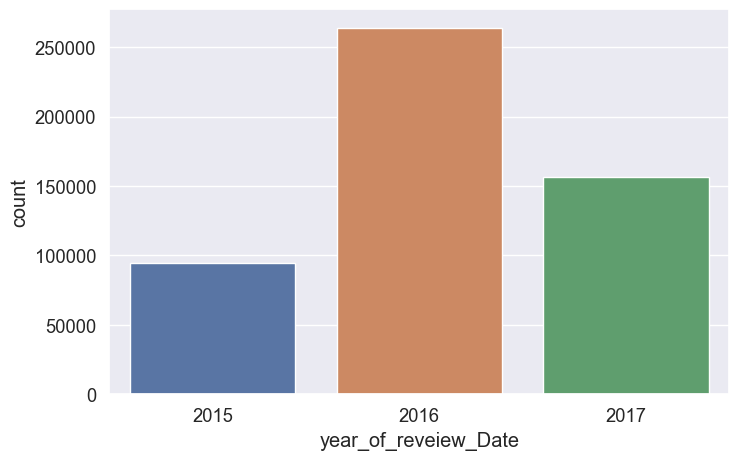

In [120]:
sns.countplot(data=df_copy,x='year_of_reveiew_Date')

<AxesSubplot:xlabel='month_of_reveiew_Date', ylabel='count'>

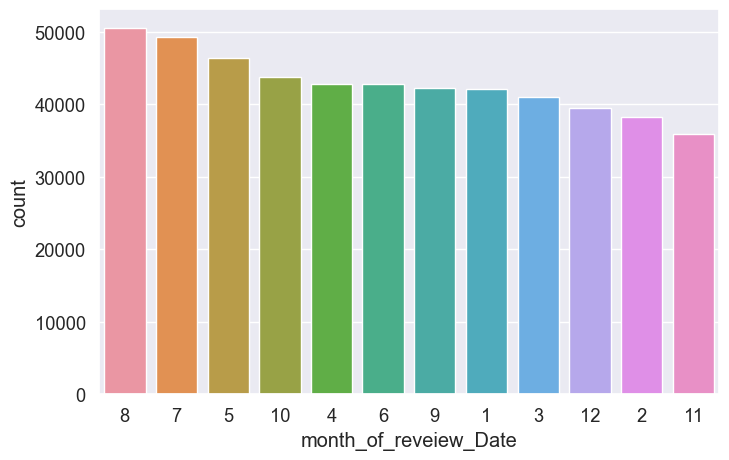

In [121]:
sns.countplot(data=df_copy,x='month_of_reveiew_Date',order=df_copy.month_of_reveiew_Date.value_counts().index)

<AxesSubplot:xlabel='day_of_reveiew_Date', ylabel='count'>

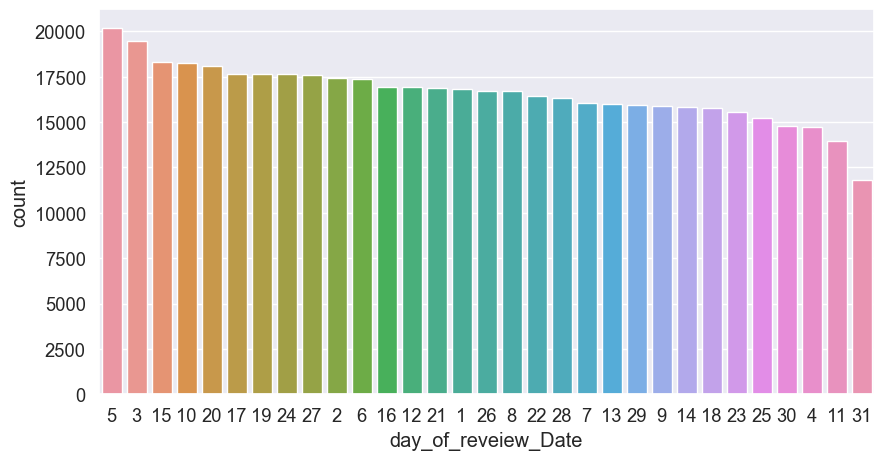

In [122]:
plt.figure(figsize=(10,5))
sns.countplot(data=df_copy,x='day_of_reveiew_Date',order=df_copy.day_of_reveiew_Date.value_counts().index)

# Column Region of reviewer 
- make region to reduce number of country to make it easier to make analysis

In [123]:
df_copy.head(1)

,Average_Score,Hotel_Name,Reviewer_Nationality,Total_Number_of_Reviews,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,negative_review,positive,guests,with_a_pet,trip_type,stayed,type_of_Room,submit_from_mobile,Country_of_Hotel,year_of_reveiew_Date,month_of_reveiew_Date,day_of_reveiew_Date
0,7.7,Hotel Arena,Russia,1403,7,2.9,angry made post available via possible site us...,park outside hotel beautiful,Couple,0,1.0,6,Duplex Double Room,0,Netherlands,2017,8,3


In [124]:
# 3shn feh masfat fe elasm f msh h3rf a3ml (in condition)
df_copy['Reviewer_Nationality'] = df_copy['Reviewer_Nationality'].str.strip()

In [125]:
Arabic_Region=['United Arab Emirates','South Sudan','Palestinian Territory','Sudan','Jordan','Kuwait','Bahrain','Egypt',
'Lebanon','Qatar','Morocco','Oman','Saudi Arabia','United Arab Emirates','Somalia','Liberia','Syria',
'Mauritania','Yemen','Tunisia','Algeria','Iraq','Libya']

In [126]:
data_countries = pd.read_csv('Downloads\data_countries.csv')
data_countries.head(2)

,timezones,code,continent,name,capital
0,['Europe/Andorra'],AD,Europe,Andorra,Andorra la Vella
1,['Asia/Kabul'],AF,Asia,Afghanistan,Kabul


In [127]:
data_countries.continent.unique()

array(['Europe', 'Asia', 'North America', 'Africa', 'South America',
       'Oceania'], dtype=object)

In [128]:
europe_list = []
for j in range(len(data_countries)):
    if data_countries['continent'][j] == 'Europe':
        europe_list.append(data_countries['name'][j])

asia_list = []
for j in range(len(data_countries)):
    if data_countries['continent'][j] == 'Asia':
        asia_list.append(data_countries['name'][j])

northamerica_list = []
for j in range(len(data_countries)):
    if data_countries['continent'][j] == 'North America':
        northamerica_list.append(data_countries['name'][j])

southamerica_list = []
for j in range(len(data_countries)):
    if data_countries['continent'][j] == 'South America':
        southamerica_list.append(data_countries['name'][j])
        
oceania_list = []
for j in range(len(data_countries)):
    if data_countries['continent'][j] == 'Oceania':
        oceania_list.append(data_countries['name'][j])

africa_list = []
for j in range(len(data_countries)):
    if data_countries['continent'][j] == 'Africa':
        africa_list.append(data_countries['name'][j])

In [129]:
northamerica_list[17] = 'United States of America'
europe_list[14] = 'Ireland'        
europe_list[23] = 'Netherlands'
asia_list[7] = 'China'

In [130]:
continent = []
for k in range(len(df_copy)):
    if df_copy['Reviewer_Nationality'][k] in europe_list:
        continent.append("Europe")
    elif df_copy['Reviewer_Nationality'][k] in asia_list:
        continent.append("Asia")
    elif df_copy['Reviewer_Nationality'][k] in africa_list:
        continent.append("Africa")
    elif df_copy['Reviewer_Nationality'][k] in oceania_list:
        continent.append("Oceania")
    elif df_copy['Reviewer_Nationality'][k] in northamerica_list:
        continent.append("North America")
    elif df_copy['Reviewer_Nationality'][k] in southamerica_list:
        continent.append("South America")
    elif df_copy['Reviewer_Nationality'][k] in Arabic_Region:
        continent.append("Arabic_Region")
    elif df_copy['Reviewer_Nationality'][k] == 'United Kingdom':
        continent.append('United Kingdom')
    else:
        continent.append("Other")

continent = pd.Series(continent)

In [131]:
df_copy['Region_of_Reviewer'] = continent

In [132]:
#Most of travellers are from Europe. Asia is the Second
df_copy['Region_of_Reviewer'].value_counts(normalize=True) * 100

United Kingdom    47.574591
Europe            21.635948
North America      8.649061
Arabic_Region      7.001002
Asia               6.702872
Oceania            4.837426
Other              1.773445
Africa             1.165734
South America      0.659923
Name: Region_of_Reviewer, dtype: float64

In [133]:
px.pie(data_frame=df_copy,names=df_copy.Region_of_Reviewer)

In [134]:
df_copy.head(1)

,Average_Score,Hotel_Name,Reviewer_Nationality,Total_Number_of_Reviews,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,negative_review,positive,guests,with_a_pet,trip_type,stayed,type_of_Room,submit_from_mobile,Country_of_Hotel,year_of_reveiew_Date,month_of_reveiew_Date,day_of_reveiew_Date,Region_of_Reviewer
0,7.7,Hotel Arena,Russia,1403,7,2.9,angry made post available via possible site us...,park outside hotel beautiful,Couple,0,1.0,6,Duplex Double Room,0,Netherlands,2017,8,3,Europe


In [135]:
df_copy.Region_of_Reviewer.value_counts()

United Kingdom    245110
Europe            111471
North America      44561
Arabic_Region      36070
Asia               34534
Oceania            24923
Other               9137
Africa              6006
South America       3400
Name: Region_of_Reviewer, dtype: int64

# column Tourist to know the guest visited from same country or out of the country

In [136]:
df_copy.Country_of_Hotel.value_counts()

UK             262298
Spain           60149
France          59413
Netherlands     57211
Austria         38937
Italy           37204
Name: Country_of_Hotel, dtype: int64

In [137]:
df_copy.Reviewer_Nationality.value_counts()

United Kingdom              245110
United States of America     35349
Australia                    21648
Ireland                      14814
United Arab Emirates         10229
                             ...  
Cape Verde                       1
Northern Mariana Islands         1
Tuvalu                           1
Guinea                           1
Palau                            1
Name: Reviewer_Nationality, Length: 227, dtype: int64

In [138]:
df_copy.Country_of_Hotel=df_copy.Country_of_Hotel.replace({'UK':'United Kingdom'})

In [139]:
tourist = []
for i in range(len(df_copy['Reviewer_Nationality'])):
    if df_copy['Reviewer_Nationality'][i] == df_copy['Country_of_Hotel'][i]:
        tourist.append(0)
    else:
        tourist.append(1)

In [140]:
df_copy['Tourist'] = tourist  

In [141]:
df_copy['Tourist'].value_counts(normalize=True)*100 # Most of the people who come are tourist

1    65.3793
0    34.6207
Name: Tourist, dtype: float64

In [142]:
df_copy[['Country_of_Hotel','Reviewer_Nationality','Tourist']].head()

,Country_of_Hotel,Reviewer_Nationality,Tourist
0,Netherlands,Russia,1
1,Netherlands,Ireland,1
2,Netherlands,Australia,1
3,Netherlands,United Kingdom,1
4,Netherlands,New Zealand,1


# Outliers

In [143]:
dfs = df_copy.copy()

<AxesSubplot:xlabel='Reviewer_Score'>

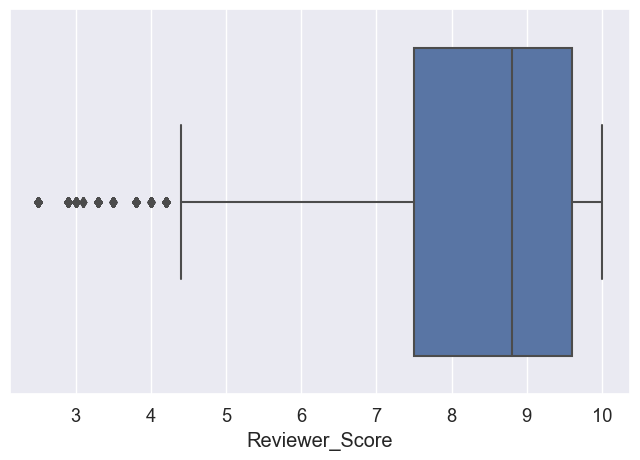

In [144]:
sns.boxplot(data=dfs,x='Reviewer_Score')

In [145]:
index=detect_outliers(dfs,0,['Reviewer_Score'])

In [146]:
dfs.loc[index]

,Average_Score,Hotel_Name,Reviewer_Nationality,Total_Number_of_Reviews,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,negative_review,positive,guests,with_a_pet,trip_type,stayed,type_of_Room,submit_from_mobile,Country_of_Hotel,year_of_reveiew_Date,month_of_reveiew_Date,day_of_reveiew_Date,Region_of_Reviewer,Tourist
0,7.7,Hotel Arena,Russia,1403,7,2.9,angry made post available via possible site us...,park outside hotel beautiful,Couple,0,1.0,6,Duplex Double Room,0,Netherlands,2017,8,3,Europe,1
3,7.7,Hotel Arena,United Kingdom,1403,1,3.8,room dirty afraid walk barefoot floor looked c...,great location nice surroundings bar restauran...,Solo traveler,0,1.0,3,Duplex Double Room,0,Netherlands,2017,7,31,United Kingdom,1
21,7.7,Hotel Arena,France,1403,12,3.8,room overrated disaster room dirty smelly hot ...,breakfast positive element hotel original tast...,Couple,0,1.0,2,Duplex Double Room,0,Netherlands,2017,6,12,Europe,1
32,7.7,Hotel Arena,United States of America,1403,1,4.2,bathroom urine order shower slippery shower ch...,positive,Group,0,1.0,3,Duplex Twin Room,1,Netherlands,2017,5,11,North America,1
42,7.7,Hotel Arena,Switzerland,1403,4,2.9,hotel going major construction renovation ment...,love design renovated product park nearby walk,Solo traveler,0,2.0,1,Large King Room,1,Netherlands,2017,4,14,Europe,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
515135,8.1,Atlantis Hotel Vienna,France,2823,6,3.8,even stop car unload front hotel insecure nigh...,positive,Family with young children,0,1.0,3,Standard Triple Room,0,Austria,2016,9,24,Europe,1
515151,8.1,Atlantis Hotel Vienna,Germany,2823,11,3.8,star hotel except breakfast,breakfast,Family with older children,0,1.0,2,Standard Triple Room,1,Austria,2016,8,19,Europe,1
515174,8.1,Atlantis Hotel Vienna,Russia,2823,2,3.8,room va located different building reception s...,positive,Solo traveler,0,2.0,3,Standard Double or Twin Room,1,Austria,2016,5,29,Europe,1
515202,8.1,Atlantis Hotel Vienna,Qatar,2823,1,4.2,everything,nothing,Couple,0,1.0,3,Standard Double or Twin Room,1,Austria,2015,9,27,Arabic_Region,1


In [147]:
dfs.drop(index,inplace=True)

In [148]:
# Average Score

<AxesSubplot:xlabel='Average_Score'>

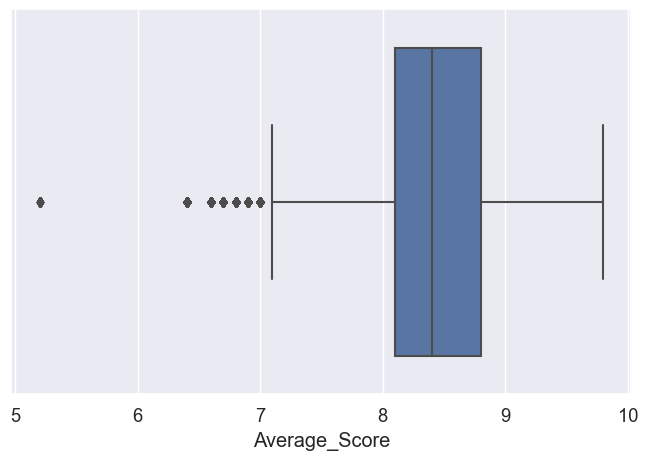

In [149]:
sns.boxplot(data=dfs,x='Average_Score')

In [150]:
index_average = detect_outliers(dfs,0,['Average_Score'])

In [151]:
len(index_average)

8080

In [152]:
dfs.drop(index_average,inplace=True)

In [153]:
dfs.head(2)

,Average_Score,Hotel_Name,Reviewer_Nationality,Total_Number_of_Reviews,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,negative_review,positive,guests,with_a_pet,trip_type,stayed,type_of_Room,submit_from_mobile,Country_of_Hotel,year_of_reveiew_Date,month_of_reveiew_Date,day_of_reveiew_Date,Region_of_Reviewer,Tourist
1,7.7,Hotel Arena,Ireland,1403,7,7.5,negative,real complaint hotel great great location surr...,Couple,0,1.0,4,Duplex Double Room,0,Netherlands,2017,8,3,Europe,1
2,7.7,Hotel Arena,Australia,1403,9,7.1,room nice elderly bit difficult room two story...,location good staff ok cute hotel breakfast ra...,Family with young children,0,1.0,3,Duplex Double Room,1,Netherlands,2017,7,31,Oceania,1


<AxesSubplot:xlabel='guests', ylabel='Reviewer_Score'>

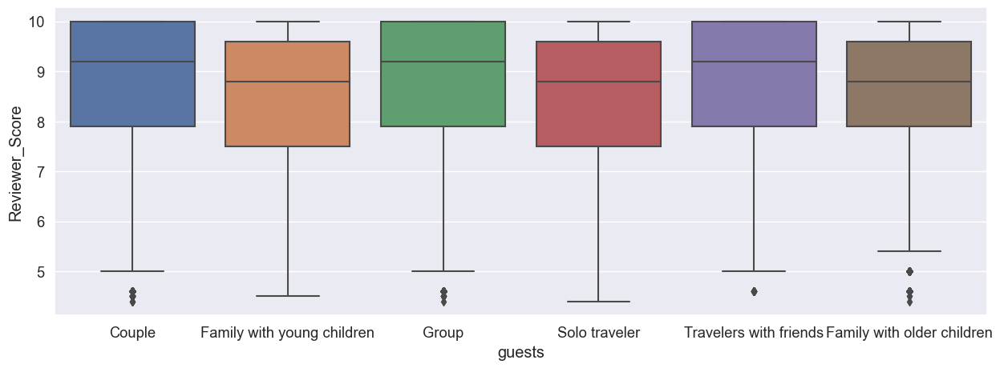

In [154]:
plt.figure(figsize=(15,5))
sns.boxplot(x='guests',y='Reviewer_Score',data=dfs)

In [155]:
# plt.figure(figsize=(15,5))
# sns.boxplot(x='guests',y='Reviewer_Score',data=df_copy)

In [156]:
# Bavriate analysis

In [157]:
df_copy.corr()['Reviewer_Score']

Average_Score                                 0.364175
Total_Number_of_Reviews                      -0.072920
Total_Number_of_Reviews_Reviewer_Has_Given    0.002885
Reviewer_Score                                1.000000
with_a_pet                                    0.000040
trip_type                                    -0.113380
stayed                                       -0.014139
submit_from_mobile                            0.014142
year_of_reveiew_Date                          0.011100
month_of_reveiew_Date                        -0.032738
day_of_reveiew_Date                           0.002837
Tourist                                      -0.009113
Name: Reviewer_Score, dtype: float64

<AxesSubplot:xlabel='trip_type', ylabel='Reviewer_Score'>

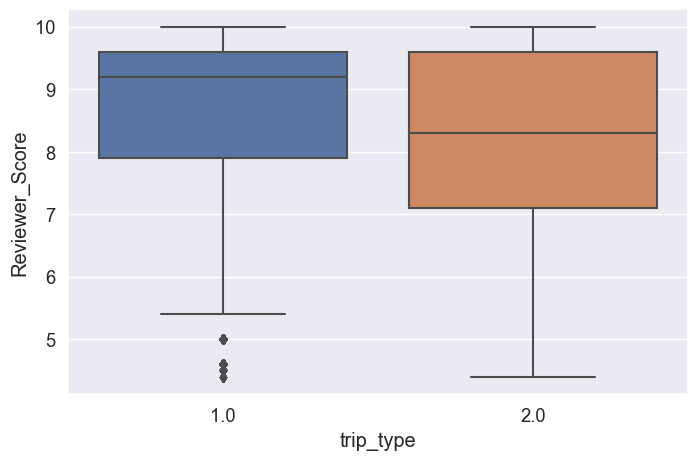

In [158]:
sns.boxplot(x='trip_type',y='Reviewer_Score',data=dfs)

<AxesSubplot:xlabel='submit_from_mobile', ylabel='Reviewer_Score'>

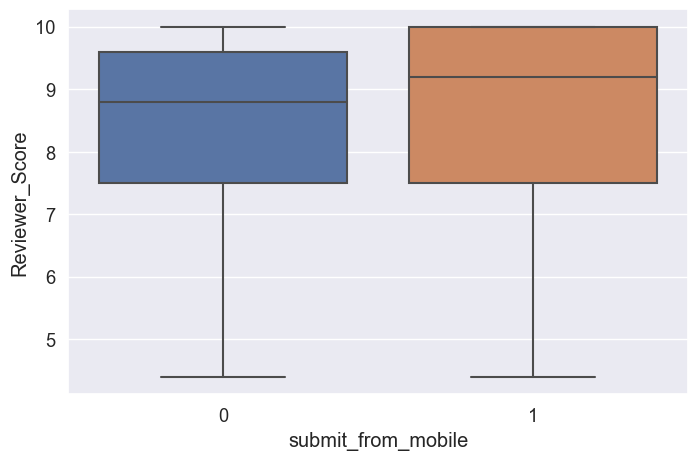

In [159]:
sns.boxplot(x='submit_from_mobile',y='Reviewer_Score',data=dfs)

<AxesSubplot:xlabel='Country_of_Hotel', ylabel='Reviewer_Score'>

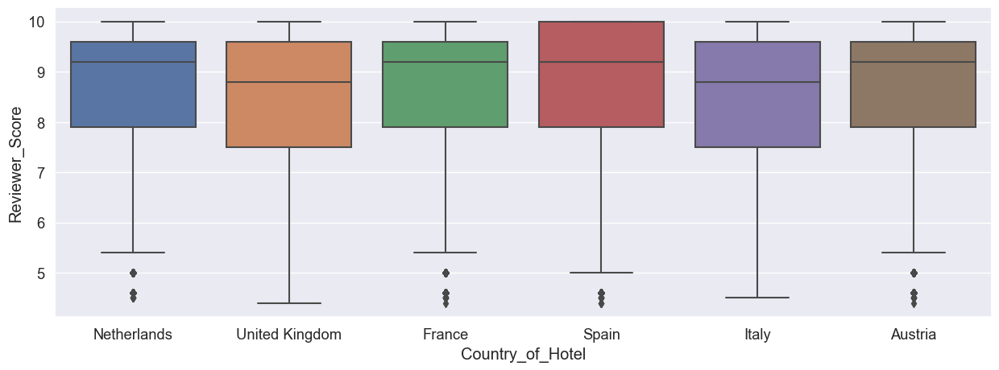

In [160]:
plt.figure(figsize=(15,5))
sns.boxplot(x='Country_of_Hotel',y='Reviewer_Score',data=dfs)

<AxesSubplot:xlabel='Region_of_Reviewer', ylabel='Reviewer_Score'>

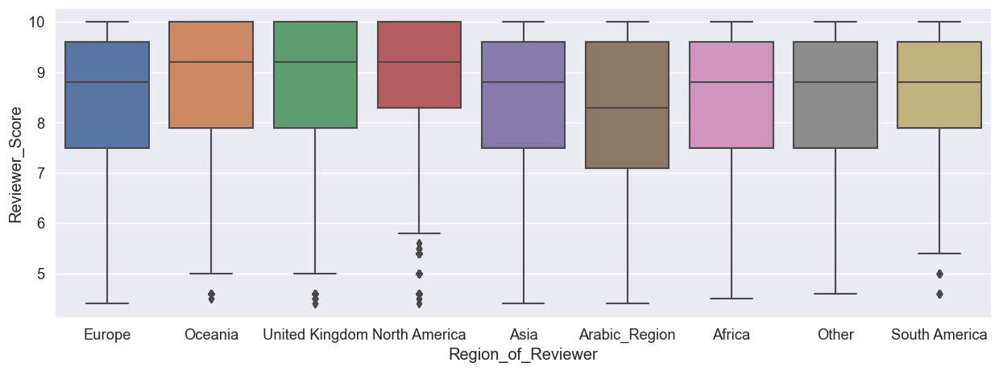

In [161]:
plt.figure(figsize=(15,5))
sns.boxplot(x='Region_of_Reviewer',y='Reviewer_Score',data=dfs)

<AxesSubplot:xlabel='Tourist', ylabel='Reviewer_Score'>

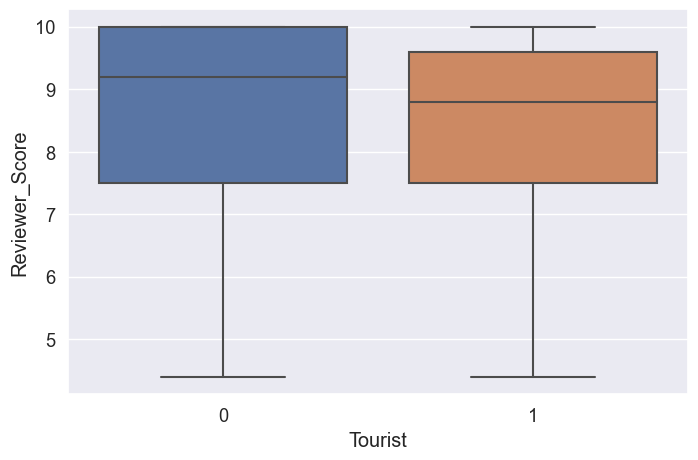

In [162]:
sns.boxplot(x='Tourist',y='Reviewer_Score',data=dfs)

In [ ]:
dfs.to_csv(r'E:\CV files\report.csv',index=False)